In [1]:
# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.
import kagglehub
andradaolteanu_gtzan_dataset_music_genre_classification_path = kagglehub.dataset_download('andradaolteanu/gtzan-dataset-music-genre-classification')

print('Data source import complete.')


100%|██████████| 1.21G/1.21G [00:26<00:00, 49.8MB/s]

Extracting files...


Data source import complete.


## Import libraries

In [5]:
# Importing all the required libraries

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import scipy
import os
import pickle
import librosa
import librosa.display
import IPython.display as ipd
from IPython.display import Audio
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import Sequential
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import soundfile as sf
import librosa
import librosa.display
from IPython.display import Audio
from tqdm import tqdm
from sklearn.model_selection import train_test_split
import tensorflow as tf
from tensorflow import keras
from keras.models import Sequential
from keras.layers import Dense, Flatten, Conv2D, MaxPooling2D, Dropout, LSTM, Bidirectional, GRU, BatchNormalization, LeakyReLU
#from keras.utils import to_categorical
import os
import math
import json
import random

In [7]:
# Reading the csv file
df = pd.read_csv("/content/features_3_sec.csv")
df.head()

,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
0,blues.00000.0.wav,66149,0.335406,0.091048,0.130405,0.003521,1773.065032,167541.630869,1972.744388,117335.771563,...,39.687145,-3.241280,36.488243,0.722209,38.099152,-5.050335,33.618073,-0.243027,43.771767,blues
1,blues.00000.1.wav,66149,0.343065,0.086147,0.112699,0.001450,1816.693777,90525.690866,2010.051501,65671.875673,...,64.748276,-6.055294,40.677654,0.159015,51.264091,-2.837699,97.030830,5.784063,59.943081,blues
2,blues.00000.2.wav,66149,0.346815,0.092243,0.132003,0.004620,1788.539719,111407.437613,2084.565132,75124.921716,...,67.336563,-1.768610,28.348579,2.378768,45.717648,-1.938424,53.050835,2.517375,33.105122,blues
3,blues.00000.3.wav,66149,0.363639,0.086856,0.132565,0.002448,1655.289045,111952.284517,1960.039988,82913.639269,...,47.739452,-3.841155,28.337118,1.218588,34.770935,-3.580352,50.836224,3.630866,32.023678,blues
4,blues.00000.4.wav,66149,0.335579,0.088129,0.143289,0.001701,1630.656199,79667.267654,1948.503884,60204.020268,...,30.336359,0.664582,45.880913,1.689446,51.363583,-3.392489,26.738789,0.536961,29.146694,blues


In [8]:
# Shape of the data
df.shape

(9990, 60)

In [9]:
# Data type of the data
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9990 entries, 0 to 9989
Data columns (total 60 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   filename                 9990 non-null   object 
 1   length                   9990 non-null   int64  
 2   chroma_stft_mean         9990 non-null   float64
 3   chroma_stft_var          9990 non-null   float64
 4   rms_mean                 9990 non-null   float64
 5   rms_var                  9990 non-null   float64
 6   spectral_centroid_mean   9990 non-null   float64
 7   spectral_centroid_var    9990 non-null   float64
 8   spectral_bandwidth_mean  9990 non-null   float64
 9   spectral_bandwidth_var   9990 non-null   float64
 10  rolloff_mean             9990 non-null   float64
 11  rolloff_var              9990 non-null   float64
 12  zero_crossing_rate_mean  9990 non-null   float64
 13  zero_crossing_rate_var   9990 non-null   float64
 14  harmony_mean            

In [11]:
# Loading a sample audio from the dataset
audio ="/content/reggae.00000.wav"
data,sr=librosa.load(audio)
print(type(data),type(sr))

<class 'numpy.ndarray'> <class 'int'>


In order to work with audio data we use [Librosa](https://librosa.org/doc/latest/index.html), a python
package used for audio and music analysis. It is a powerful package widely used for
audio visualization and for building MIR systems. We will be using the package for
loading and visualizing the audio data.

In [12]:
# Initializing sample rate to 45600 we obtain the signal value array
librosa.load(audio,sr=45600)

(array([ 0.00971869,  0.00959029,  0.00767962, ..., -0.0455722 ,
        -0.0340015 , -0.01597212], dtype=float32),
 45600)

In [13]:
# Taking Short-time Fourier transform of the signal
y = librosa.stft(data)
S_db = librosa.amplitude_to_db(np.abs(y), ref=np.max)

In [14]:
# Playing audio file
import IPython
IPython.display.Audio(data,rate=sr)

It is important to note that while working with any kind of audio data to solve any kind of problem statement, using only .wav format audio files is appropriate to analyze the data. If you are given audio files with .mp3 format you have to batch convert the data to waveforms using online software as .wav is the standard way of representing the audio files and it is the only way to work with audio data. Below is the wave form representation on the audio

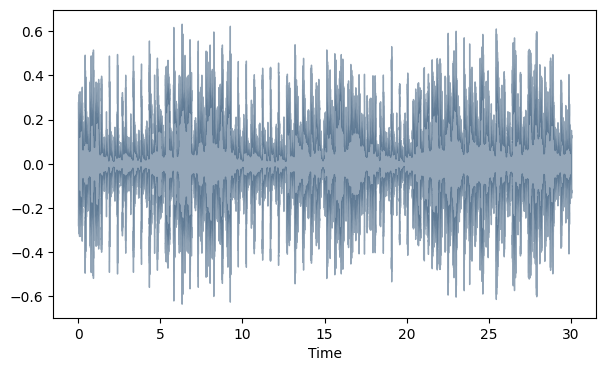

In [15]:
# Wave form of the audio
plt.figure(figsize=(7,4))
librosa.display.waveshow(data,color="#2B4F72", alpha = 0.5)
plt.show()

A spectrogram is a visual representation of the signal loudness of a signal over time at different frequencies included in a certain waveform. We can examine increase or decrease of energy over period of time. Spectrograms are also known as sonographs, voiceprints, and voicegrams.  We can also know how energy levels change over time period.

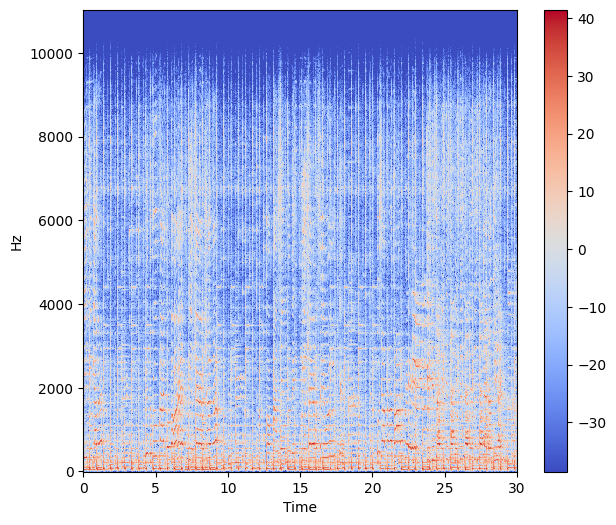

In [16]:
# Spectrogram of the audio
stft=librosa.stft(data)
stft_db=librosa.amplitude_to_db(abs(stft))
plt.figure(figsize=(7,6))
librosa.display.specshow(stft_db,sr=sr,x_axis='time',y_axis='hz')
plt.colorbar()

## Data Pre Processing

### Extracting Audio features
The process of extraction of features from the data to utilize them for analysis is
known as feature extraction. Each audio signal consists of various audio features
however we must extract features that are relevant to the problem that we are solving.
Here are some features listed which are used in our project.

### Spectral roll off
It computes the rolloff frequency for each frame in a given signal. The frequency under which some percentage (cutoff) of the total energy of a spectrum is obtained. It can be used to differentiate between the harmonic and noisy sounds.   Spectral Roll off

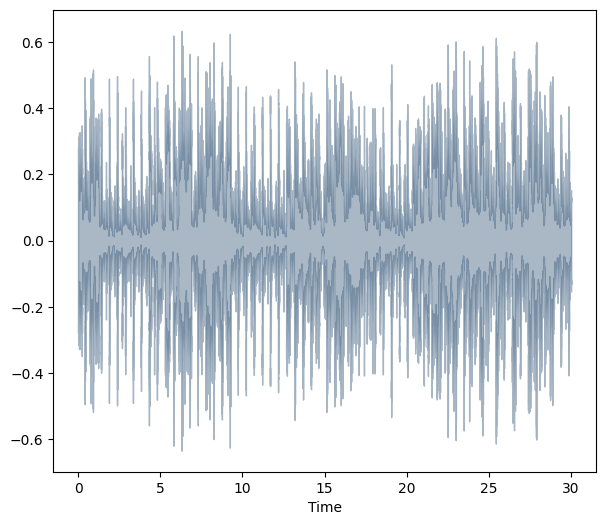

In [17]:
spectral_rolloff=librosa.feature.spectral_rolloff(y=data,sr=sr)[0]
plt.figure(figsize=(7,6))
librosa.display.waveshow(data,sr=sr,alpha=0.4,color="#2B4F72")

### Chroma feature
It closely relates with the twelve different pitch classes. Chroma based features are also called as pitch class profiles. It is the powerful tool for analyzing and categorizing them. Harmonic and melodic characteristics of music are captured by them. Chroma featue

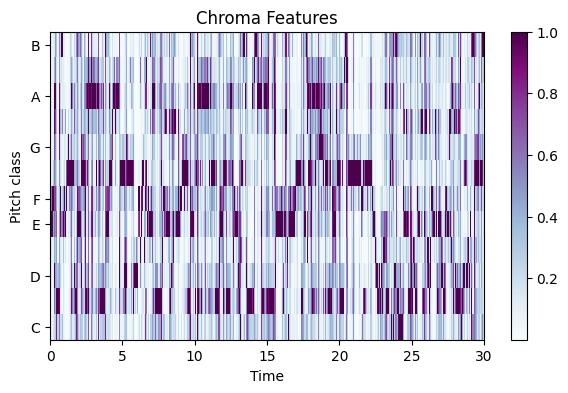

In [18]:
import librosa.display as lplt
chroma = librosa.feature.chroma_stft(y=data,sr=sr)
plt.figure(figsize=(7,4))
lplt.specshow(chroma,sr=sr,x_axis="time",y_axis="chroma",cmap="BuPu")
plt.colorbar()
plt.title("Chroma Features")
plt.show()

### Zero Crossing Rate
It is the rate at which a signal transitions from positive to zero to negative or from negative to zero or simply said the number of times the signal crosses x-axis is as the zero-crossing rate (ZCR).

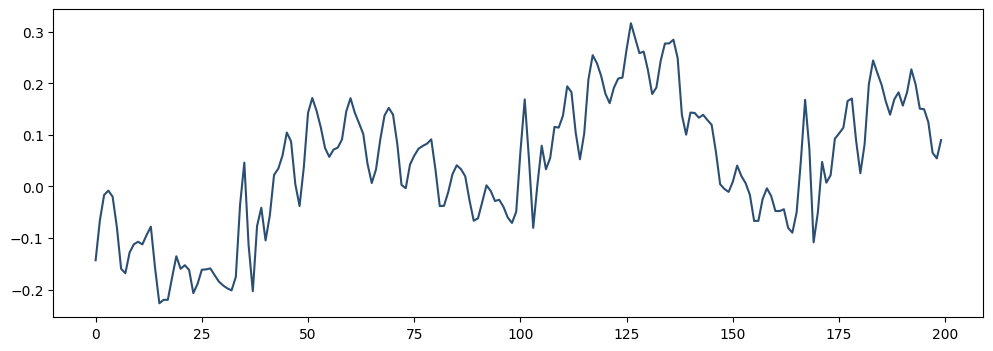

In [19]:
start=1000
end=1200
plt.figure(figsize=(12,4))
plt.plot(data[start:end],color="#2B4F72")

In [20]:
# Printing the number of times signal crosses the x-axis
zero_cross_rate=librosa.zero_crossings(data[start:end],pad=False)
print("The number of zero_crossings are :", sum(zero_cross_rate))

The number of zero_crossings are : 21


## Exploratory Data Analysis(EDA)
Vizualizing the audio files, wave plots and spectrograms for all the 10 genre classes

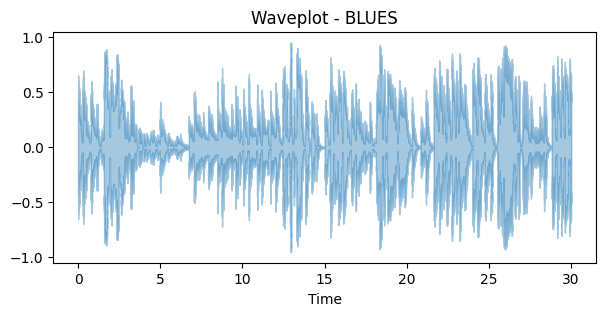

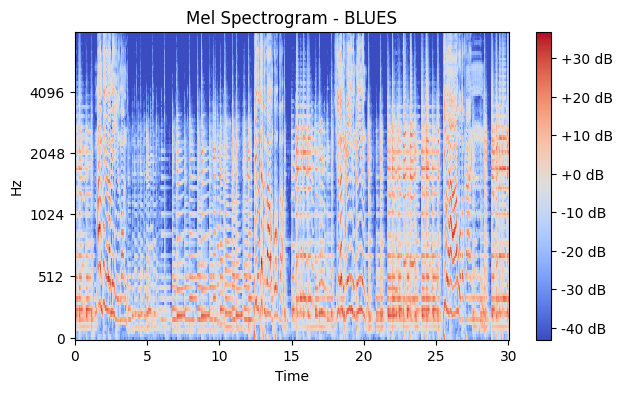

In [21]:
# EDA for all the music genre classes

# 1. BLUES
audio1= '/content/blues.00006.wav'
data, sr = librosa.load(audio1)
plt.figure(figsize=(7, 3))
librosa.display.waveshow(data, sr=sr,alpha=0.4,)
plt.title('Waveplot - BLUES')

# Creating log mel spectrogram
plt.figure(figsize=(7, 4))
spectrogram = librosa.feature.melspectrogram(y=data, sr=sr, n_mels=128,fmax=8000)
spectrogram = librosa.power_to_db(spectrogram)
librosa.display.specshow(spectrogram, y_axis='mel', fmax=8000, x_axis='time');
plt.title('Mel Spectrogram - BLUES')
plt.colorbar(format='%+2.0f dB');
# playing audio
ipd.Audio(audio1)

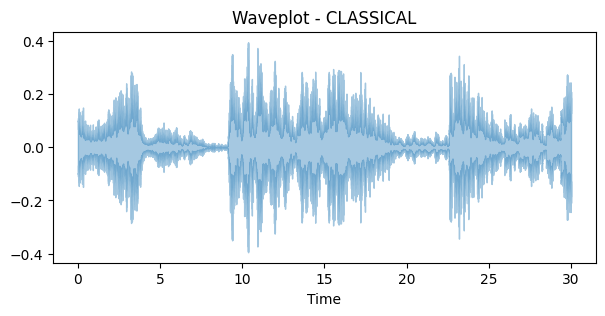

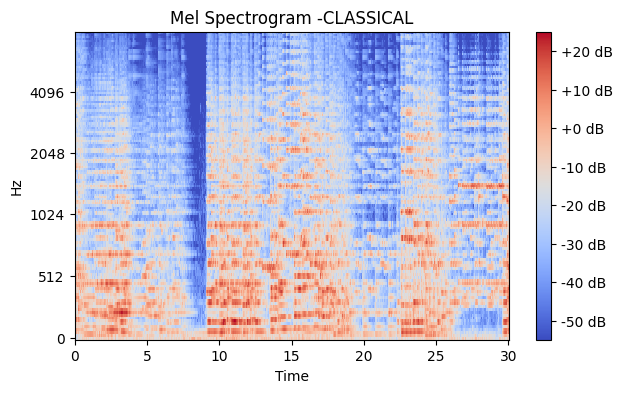

In [23]:
# 2. CLASSICAL -
audio1= '/content/classical.00007.wav'
data, sr = librosa.load(audio1)
plt.figure(figsize=(7, 3))
librosa.display.waveshow(data, sr=sr,alpha=0.4)
plt.title('Waveplot - CLASSICAL')

# Creating log mel spectrogram
plt.figure(figsize=(7, 4))
spectrogram = librosa.feature.melspectrogram(y=data, sr=sr, n_mels=128,fmax=8000)
spectrogram = librosa.power_to_db(spectrogram)
librosa.display.specshow(spectrogram, y_axis='mel', fmax=8000, x_axis='time');
plt.title('Mel Spectrogram -CLASSICAL')
plt.colorbar(format='%+2.0f dB');

# playing audio
ipd.Audio(audio1)

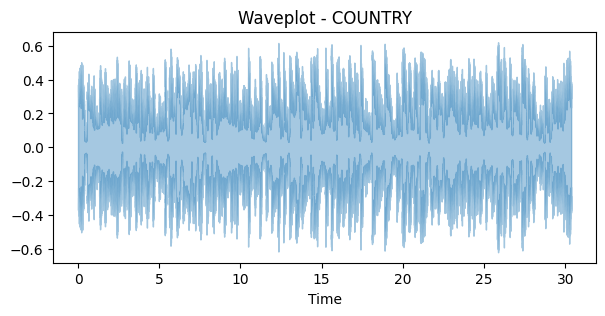

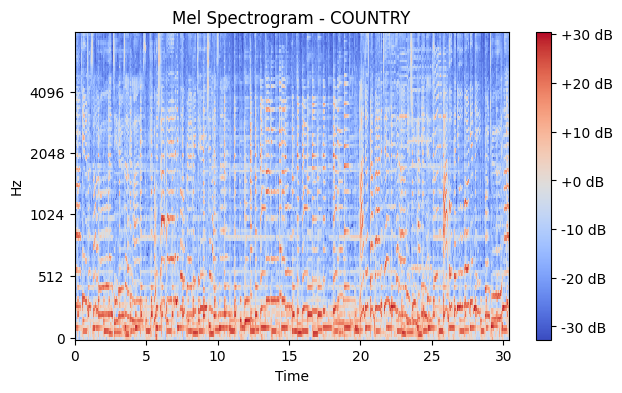

In [24]:
# 3. COUNTRY
audio1= '/content/country.00002.wav'
data, sr = librosa.load(audio1)
plt.figure(figsize=(7, 3))
librosa.display.waveshow(data, sr=sr,alpha=0.4)
plt.title('Waveplot - COUNTRY')

# Ccreating log mel spectrogram
plt.figure(figsize=(7, 4))
spectrogram = librosa.feature.melspectrogram(y=data, sr=sr, n_mels=128,fmax=8000)
spectrogram = librosa.power_to_db(spectrogram)
librosa.display.specshow(spectrogram, y_axis='mel', fmax=8000, x_axis='time');
plt.title('Mel Spectrogram - COUNTRY')
plt.colorbar(format='%+2.0f dB');

# playing audio
ipd.Audio(audio1)

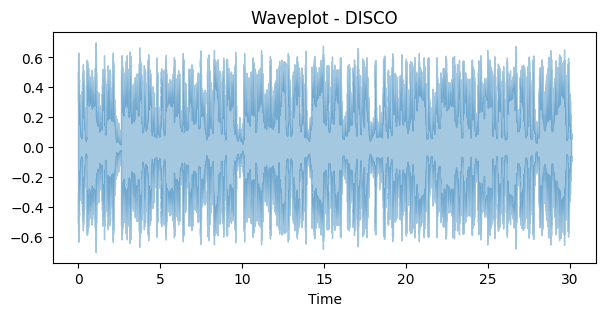

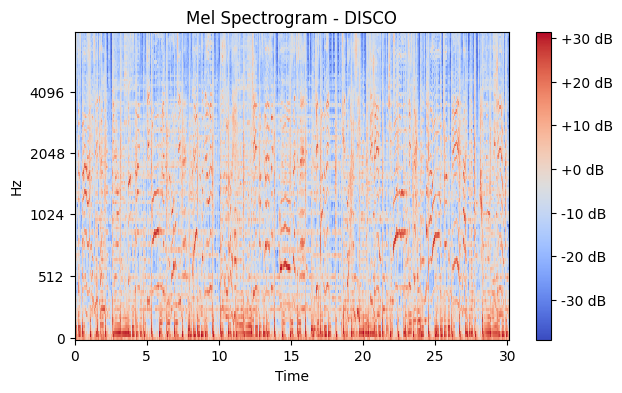

In [25]:
# 4. DISCO
audio1= '/content/disco.00012.wav'
data, sr = librosa.load(audio1)
plt.figure(figsize=(7, 3))
librosa.display.waveshow(data, sr=sr,alpha=0.4)
plt.title('Waveplot - DISCO')

# Creating log mel spectrogram
plt.figure(figsize=(7, 4))
spectrogram = librosa.feature.melspectrogram(y=data, sr=sr, n_mels=128,fmax=8000)
spectrogram = librosa.power_to_db(spectrogram)
librosa.display.specshow(spectrogram, y_axis='mel', fmax=8000, x_axis='time');
plt.title('Mel Spectrogram - DISCO')
plt.colorbar(format='%+2.0f dB');
# playing audio
ipd.Audio(audio1)

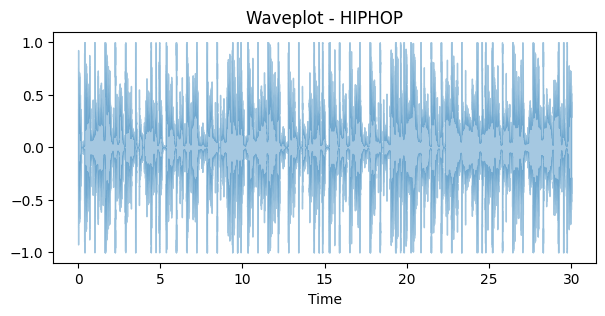

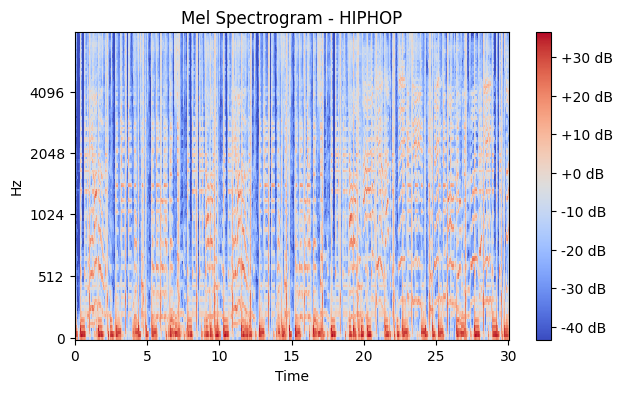

In [26]:
# 5. HIPHOP
audio1= '/content/hiphop.00004.wav'
data, sr = librosa.load(audio1)
plt.figure(figsize=(7, 3))
librosa.display.waveshow(data, sr=sr, alpha = 0.4)
plt.title('Waveplot - HIPHOP')

# Creating log mel spectrogram
plt.figure(figsize=(7, 4))
spectrogram = librosa.feature.melspectrogram(y=data, sr=sr, n_mels=128,fmax=8000,)
spectrogram = librosa.power_to_db(spectrogram)
librosa.display.specshow(spectrogram, y_axis='mel', fmax=8000, x_axis='time');
plt.title('Mel Spectrogram - HIPHOP')
plt.colorbar(format='%+2.0f dB');

# playing audio
ipd.Audio(audio1)

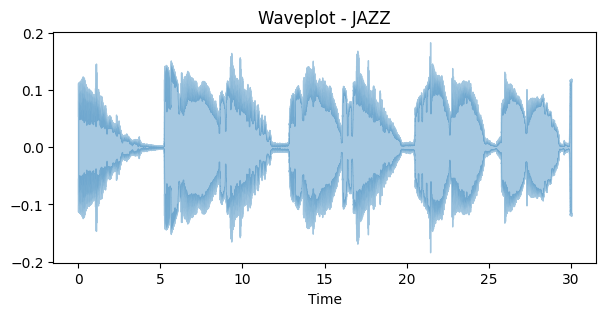

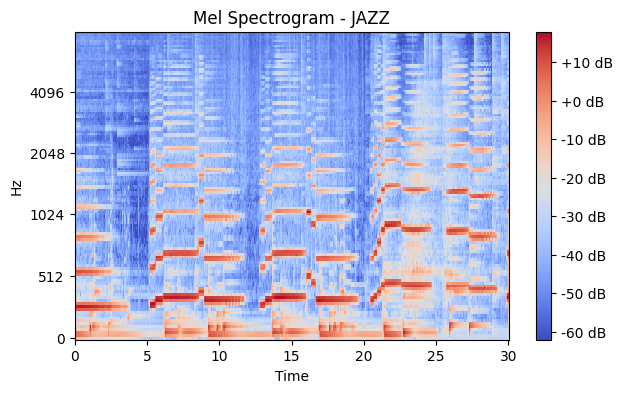

In [27]:
# 6. JAZZ
audio1= '/content/jazz.00026.wav'
data, sr = librosa.load(audio1)
plt.figure(figsize=(7, 3))
librosa.display.waveshow(data, sr=sr,alpha=0.4)
plt.title('Waveplot - JAZZ')

# Creating log mel spectrogram
plt.figure(figsize=(7, 4))
spectrogram = librosa.feature.melspectrogram(y=data, sr=sr, n_mels=128,fmax=8000)
spectrogram = librosa.power_to_db(spectrogram)
librosa.display.specshow(spectrogram, y_axis='mel', fmax=8000, x_axis='time');
plt.title('Mel Spectrogram - JAZZ')
plt.colorbar(format='%+2.0f dB');

# playing audio
ipd.Audio(audio1)

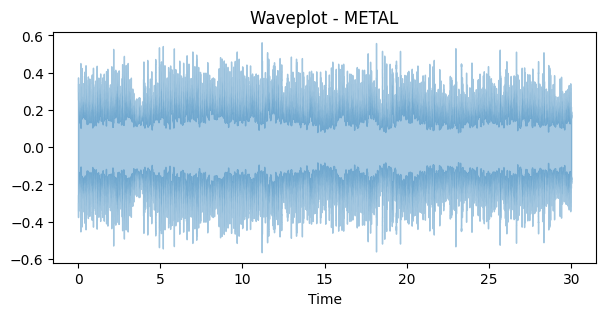

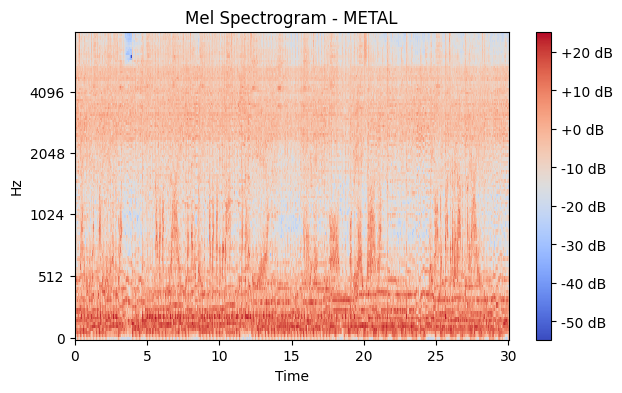

In [28]:
# 7. METAL
audio1= '/content/metal.00015.wav'
data, sr = librosa.load(audio1)
plt.figure(figsize=(7, 3))
librosa.display.waveshow(data, sr=sr,alpha=0.4)
plt.title('Waveplot - METAL')

# creating log mel spectrogram
plt.figure(figsize=(7, 4))
spectrogram = librosa.feature.melspectrogram(y=data, sr=sr, n_mels=128,fmax=8000)
spectrogram = librosa.power_to_db(spectrogram)
librosa.display.specshow(spectrogram, y_axis='mel', fmax=8000, x_axis='time');
plt.title('Mel Spectrogram - METAL')
plt.colorbar(format='%+2.0f dB');

# playing audio
ipd.Audio(audio1)

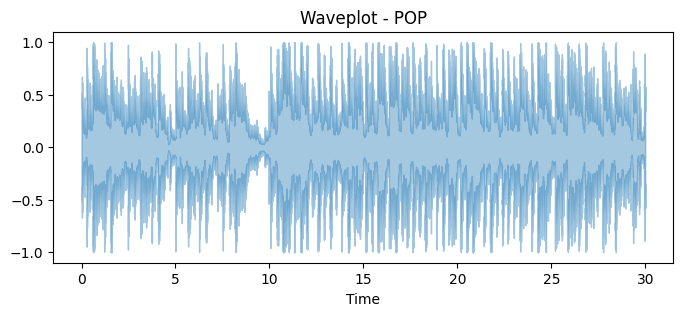

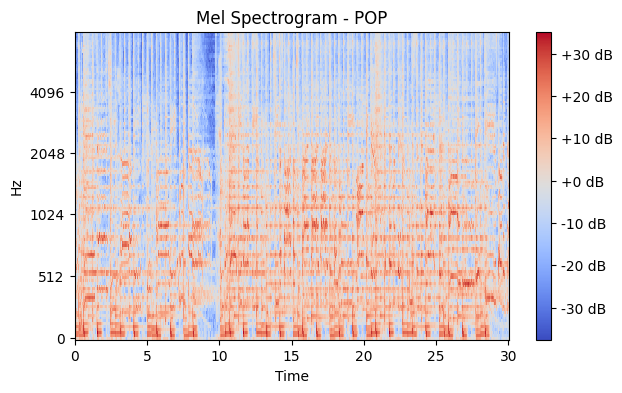

In [29]:
# 8. POP
audio1= '/content/pop.00030.wav'
data, sr = librosa.load(audio1)
plt.figure(figsize=(8, 3))
librosa.display.waveshow(data, sr=sr,alpha=0.4)
plt.title('Waveplot - POP')

# Creating log mel spectrogram
plt.figure(figsize=(7, 4))
spectrogram = librosa.feature.melspectrogram(y=data, sr=sr, n_mels=128,fmax=8000)
spectrogram = librosa.power_to_db(spectrogram)
librosa.display.specshow(spectrogram, y_axis='mel', fmax=8000, x_axis='time');
plt.title('Mel Spectrogram - POP')
plt.colorbar(format='%+2.0f dB');

# playing audio
ipd.Audio(audio1)


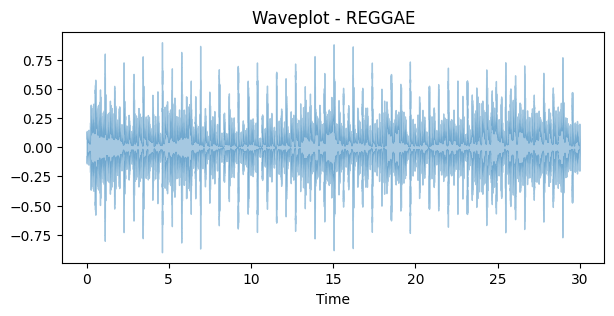

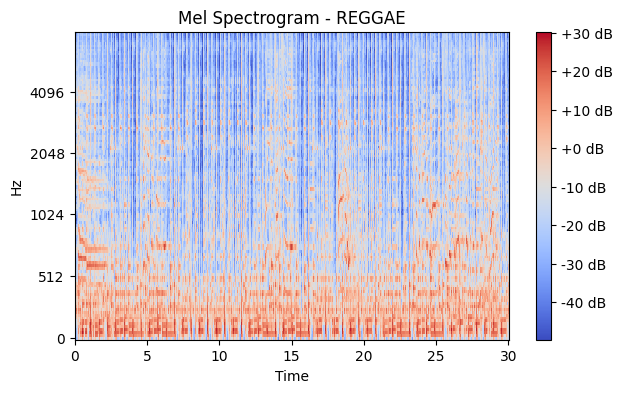

In [30]:
# 9. REGGAE
audio1= '/content/reggae.00002.wav'
data, sr = librosa.load(audio1)
plt.figure(figsize=(7, 3))
librosa.display.waveshow(data, sr=sr,alpha=0.4)
plt.title('Waveplot - REGGAE')

# Creating log mel spectrogram
plt.figure(figsize=(7, 4))
spectrogram = librosa.feature.melspectrogram(y=data, sr=sr, n_mels=128,fmax=8000)
spectrogram = librosa.power_to_db(spectrogram)
librosa.display.specshow(spectrogram, y_axis='mel', fmax=8000, x_axis='time');
plt.title('Mel Spectrogram - REGGAE')
plt.colorbar(format='%+2.0f dB');

# playing audio
ipd.Audio(audio1)

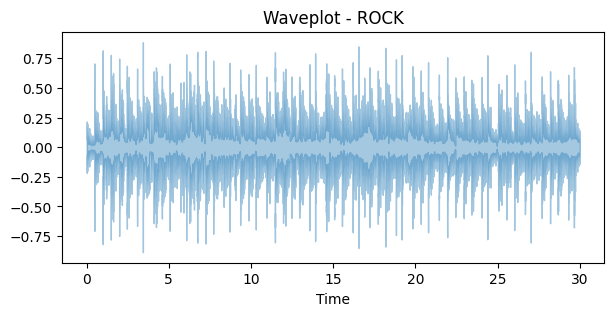

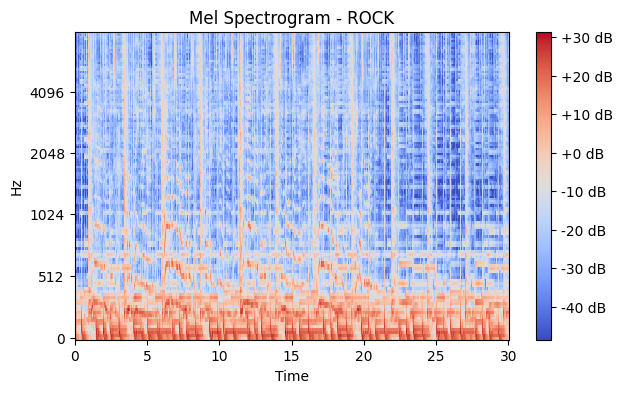

In [31]:
# 10.ROCK
audio1= '/content/rock.00013.wav'
data, sr = librosa.load(audio1)
plt.figure(figsize=(7, 3))
librosa.display.waveshow(data, sr=sr,alpha=0.4)
plt.title('Waveplot - ROCK')

# Creating log mel spectrogram
plt.figure(figsize=(7, 4))
spectrogram = librosa.feature.melspectrogram(y=data, sr=sr, n_mels=128,fmax=8000)
spectrogram = librosa.power_to_db(spectrogram)
librosa.display.specshow(spectrogram, y_axis='mel', fmax=8000, x_axis='time');
plt.title('Mel Spectrogram - ROCK')
plt.colorbar(format='%+2.0f dB');

# Playing audio
ipd.Audio(audio1)

In [32]:
# Finding misssing values
# Find all columns with any NA values
print("Columns containing missing values",list(df.columns[df.isnull().any()]))

Columns containing missing values []


In [33]:
import seaborn as sns

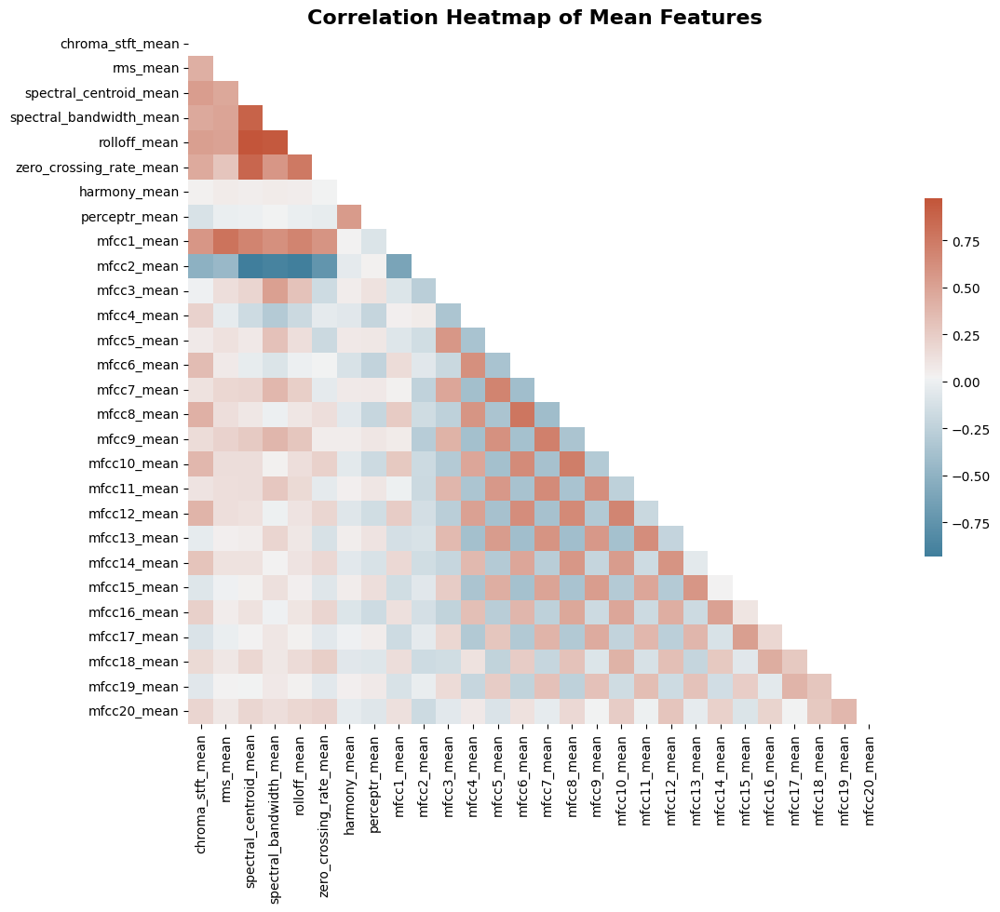

In [34]:
mean_columns = df.filter(regex='_mean$')

correlation_matrix = mean_columns.corr()

# Create a boolean mask for the upper triangle of the matrix
mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))

# Set up the matplotlib figure
plt.figure(figsize=(12, 10))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(correlation_matrix, mask=mask, cmap=cmap, annot=False, linewidths=0,
            cbar_kws={"shrink": .5}, square=True)

# Add a title to the heatmap
plt.title('Correlation Heatmap of Mean Features', fontsize=16, fontweight='bold')

# Show the plot
plt.show()

<ipython-input-35-24b9d457261a>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="label", y="tempo", data=x, palette='husl')


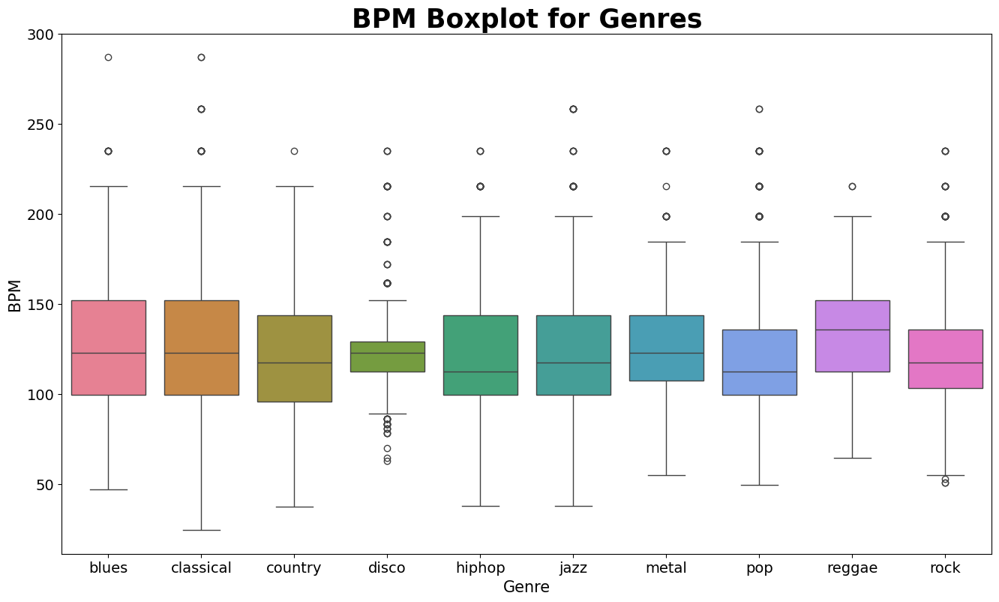

In [35]:
x = df[["label", "tempo"]]

# Create the plot
f, ax = plt.subplots(figsize=(16, 9))
sns.boxplot(x="label", y="tempo", data=x, palette='husl')

# Styling the plot with titles and labels
plt.title('BPM Boxplot for Genres', fontsize=25, fontweight='bold')
plt.xlabel("Genre", fontsize=15)
plt.ylabel("BPM", fontsize=15)

# Setting the font size for x and y ticks for better readability
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)

# Show the plot
plt.show()

In [36]:
# Label Encoding - encod the categorical classes with numerical integer values for training

# Blues - 0
# Classical - 1
# Country - 2
# Disco - 3
# Hip-hop - 4
# Jazz - 5
# Metal - 6
# Pop - 7
# Reggae - 8
# Rock - 9

y=df.iloc[:,-1]
#converter=LabelEncoder()
#y=converter.fit_transform(class_encod)
#y

In [37]:
# Drop the column filename as it is no longer required for training
df=df.drop(labels="filename",axis=1)

In [38]:
#scaling
from sklearn.preprocessing import StandardScaler,MinMaxScaler
fit=MinMaxScaler()
#X=fit.fit_transform(np.array(df.iloc[:,:-1],dtype=float))

# splitting 70% data into training set and the remaining 30% to test set
x_train,x_test,y_train,y_test=train_test_split(df.iloc[:,:-1],y,test_size=0.3)

In [39]:
X_train=fit.fit_transform(x_train)
X_test=fit.transform(x_test)

In [40]:
# test data size
len(y_test)

2997

In [41]:
# size of training data
len(y_train)

6993

In [42]:
'''
from sklearn.model_selection import GridSearchCV,RandomizedSearchCV
from sklearn.linear_model import LogisticRegression
param_grid = {'C': [0.1,10, 100],
              'penalty': ['l1', 'l2'],
              'solver': ['liblinear']}


logreg = LogisticRegression(max_iter=2000)


grid_search = RandomizedSearchCV(logreg, param_grid, cv=5, scoring='accuracy')
grid_search.fit(X_train, y_train)

print("Best hyperparameters:", grid_search.best_params_)
print("Best accuracy score:", grid_search.best_score_)

best_logreg = grid_search.best_estimator_
y_pred = best_logreg.predict(X_test)

print(classification_report(y_test, y_pred))
'''

'\nfrom sklearn.model_selection import GridSearchCV,RandomizedSearchCV\nfrom sklearn.linear_model import LogisticRegression\nparam_grid = {\'C\': [0.1,10, 100],\n              \'penalty\': [\'l1\', \'l2\'],\n              \'solver\': [\'liblinear\']}\n\n\nlogreg = LogisticRegression(max_iter=2000)\n\n\ngrid_search = RandomizedSearchCV(logreg, param_grid, cv=5, scoring=\'accuracy\')\ngrid_search.fit(X_train, y_train)\n\nprint("Best hyperparameters:", grid_search.best_params_)\nprint("Best accuracy score:", grid_search.best_score_)\n\nbest_logreg = grid_search.best_estimator_\ny_pred = best_logreg.predict(X_test)\n\nprint(classification_report(y_test, y_pred))\n'

## K-Nearest Neighbors (KNN)
KNN is a fundamental Machine learning algorithm that is most commonly used
among all kinds of problems. It classifies the data points based on the point that is
near them by finding the euclidians distance given by d = ((x2-x1)^2 - (y2-y1)^2)^1/2 as a metric.

Training set score: 0.961
Test set score: 0.903
              precision    recall  f1-score   support

       blues       0.89      0.92      0.91       286
   classical       0.91      0.97      0.93       297
     country       0.83      0.89      0.86       309
       disco       0.85      0.93      0.89       300
      hiphop       0.92      0.89      0.91       300
        jazz       0.91      0.85      0.88       287
       metal       0.97      0.95      0.96       297
         pop       0.96      0.88      0.92       305
      reggae       0.92      0.94      0.93       294
        rock       0.89      0.82      0.85       322

    accuracy                           0.90      2997
   macro avg       0.90      0.90      0.90      2997
weighted avg       0.90      0.90      0.90      2997



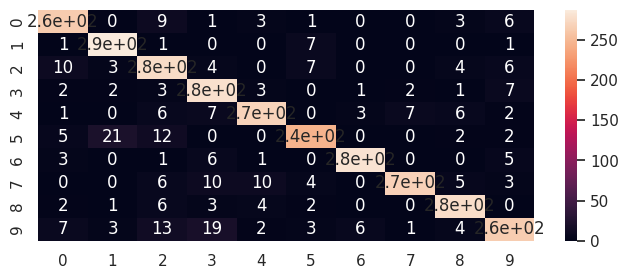

In [43]:
# Applying K nearest Neighbour algorithm to predict the results
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

clf1=KNeighborsClassifier(n_neighbors=3)
clf1.fit(X_train,y_train)
y_pred=clf1.predict(X_test)
print("Training set score: {:.3f}".format(clf1.score(X_train, y_train)))
print("Test set score: {:.3f}".format(clf1.score(X_test, y_test)))
cf_matrix = confusion_matrix(y_test, y_pred)
sns.set(rc = {'figure.figsize':(8,3)})
sns.heatmap(cf_matrix, annot=True)
print(classification_report(y_test,y_pred))

## Support Vector Machine (SVM)
SVM is one of the best machine learning models. Since the data is not linearly
separable, we have used the SVM kernel function as sigmoid. The sigmoid function is
given by
K(yn,yi) = tanh(-gamma*(yn,yi)+r)

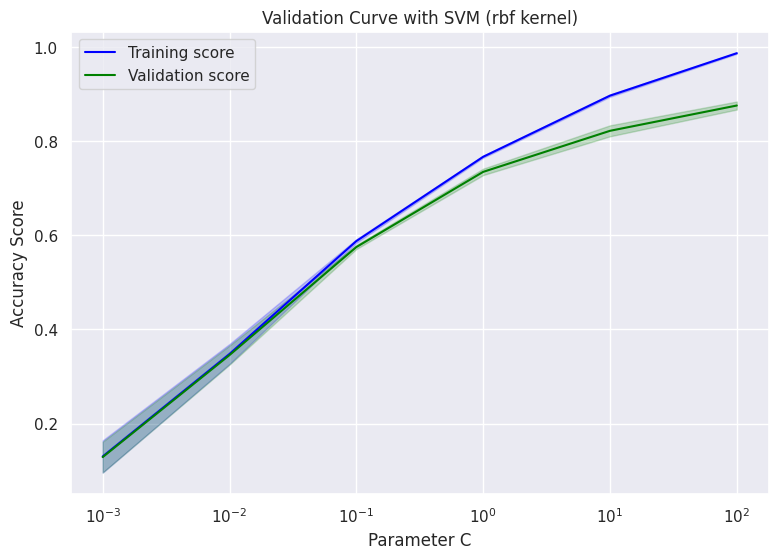

In [44]:
from sklearn.svm import SVC
from sklearn.model_selection import validation_curve
import matplotlib.pyplot as plt
import numpy as np

# Define a range of values for C (regularization parameter)
param_range = np.logspace(-3, 2, 6) # Example range from 0.001 to 100

# Use validation_curve to get training and test scores
train_scores, test_scores = validation_curve(
    SVC(kernel='rbf', degree=8),
    X_train, y_train,
    param_name="C",
    param_range=param_range,
    scoring="accuracy",
    cv=5
)

# Calculate mean and standard deviation for training and validation scores
train_mean = np.mean(train_scores, axis=1)
train_std = np.std(train_scores, axis=1)
test_mean = np.mean(test_scores, axis=1)
test_std = np.std(test_scores, axis=1)

# Plot the results
plt.figure(figsize=(9, 6))
plt.plot(param_range, train_mean, label="Training score", color="blue")
plt.fill_between(param_range, train_mean - train_std, train_mean + train_std, color="blue", alpha=0.2)

plt.plot(param_range, test_mean, label="Validation score", color="green")
plt.fill_between(param_range, test_mean - test_std, test_mean + test_std, color="green", alpha=0.2)

plt.xscale("log")
plt.xlabel("Parameter C")
plt.ylabel("Accuracy Score")
plt.title("Validation Curve with SVM (rbf kernel)")
plt.legend(loc="best")
plt.show()


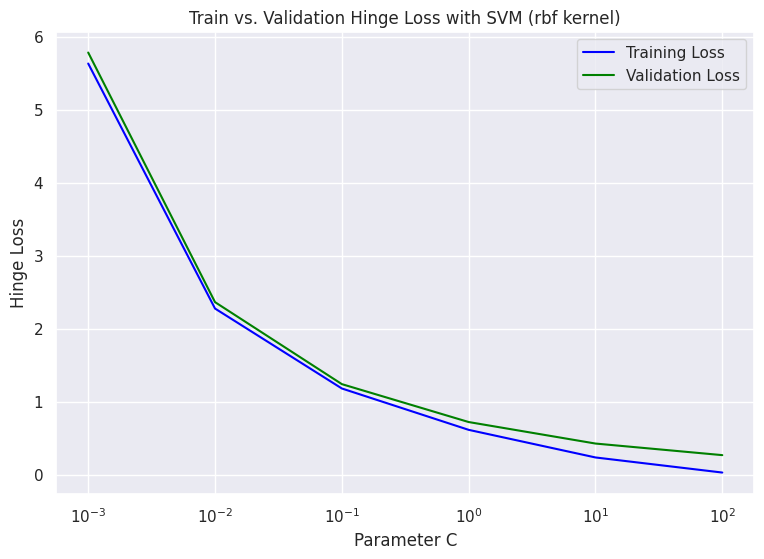

In [45]:
from sklearn.svm import SVC
from sklearn.model_selection import validation_curve
from sklearn.metrics import hinge_loss
import numpy as np
import matplotlib.pyplot as plt

# Define a range of values for the C parameter
param_range = np.logspace(-3, 2, 6)

# Initialize lists to store the calculated hinge losses
train_losses = []
val_losses = []

for c in param_range:
    # Create and train an SVM classifier with current C value
    svm = SVC(kernel='rbf', degree=8, C=c)
    svm.fit(X_train, y_train)

    # Predict on training and validation sets
    y_train_pred = svm.decision_function(X_train)
    y_val_pred = svm.decision_function(X_test)

    # Calculate hinge loss on both sets
    train_loss = hinge_loss(y_train, y_train_pred)
    val_loss = hinge_loss(y_test, y_val_pred)

    train_losses.append(train_loss)
    val_losses.append(val_loss)

# Plot the hinge loss over the parameter C
plt.figure(figsize=(9, 6))
plt.plot(param_range, train_losses, label="Training Loss", color="blue")
plt.plot(param_range, val_losses, label="Validation Loss", color="green")

plt.xscale("log")
plt.xlabel("Parameter C")
plt.ylabel("Hinge Loss")
plt.title("Train vs. Validation Hinge Loss with SVM (rbf kernel)")
plt.legend(loc="best")
plt.show()


Training set score: 0.776
Test set score: 0.749
              precision    recall  f1-score   support

       blues       0.70      0.77      0.74       286
   classical       0.89      0.94      0.91       297
     country       0.71      0.67      0.69       309
       disco       0.62      0.70      0.66       300
      hiphop       0.76      0.67      0.71       300
        jazz       0.78      0.80      0.79       287
       metal       0.82      0.87      0.84       297
         pop       0.87      0.79      0.83       305
      reggae       0.72      0.77      0.74       294
        rock       0.62      0.53      0.57       322

    accuracy                           0.75      2997
   macro avg       0.75      0.75      0.75      2997
weighted avg       0.75      0.75      0.75      2997



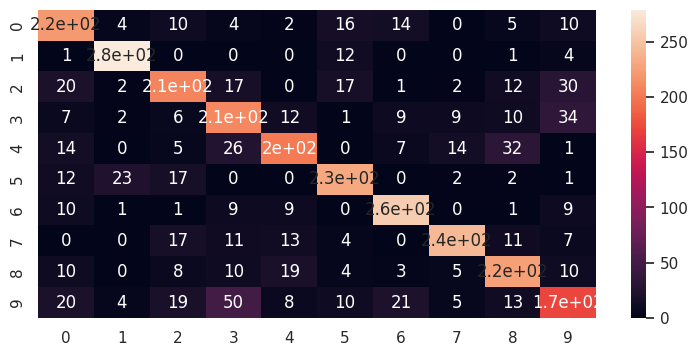

In [46]:
# Applying Support Vector Machines to predict the results
from sklearn.svm import SVC
svclassifier = SVC(kernel='rbf', degree=8)
svclassifier.fit(X_train, y_train)
print("Training set score: {:.3f}".format(svclassifier.score(X_train, y_train)))
print("Test set score: {:.3f}".format(svclassifier.score(X_test, y_test)))
y_pred = svclassifier.predict(X_test)
cf_matrix3 = confusion_matrix(y_test, y_pred)
sns.set(rc = {'figure.figsize':(9,4)})
sns.heatmap(cf_matrix3, annot=True)
print(classification_report(y_test, y_pred))

## Convolutional Neural Networks (CNN)
Using neural networks is the best way to classify huge data to draw predictions.
Convolutions can solve the given problem very precisely and the algorithm has already been
used most widely in classifying the image data.

##### Model Architecture
![Untitled Diagram.drawio (3).png](attachment:3b6f9b21-84f5-46e5-a897-2553136525be.png)

In [47]:
def Validation_plot(history):
    print("Validation Accuracy",max(history.history["val_accuracy"]))
    pd.DataFrame(history.history).plot(figsize=(12,6))
    plt.show()

In [48]:
from sklearn.preprocessing import OneHotEncoder
encoder = OneHotEncoder(handle_unknown='ignore')

y_train_encoded = encoder.fit_transform(np.array(y_train).reshape(-1, 1)).toarray()
y_test_encoded = encoder.transform(np.array(y_test).reshape(-1, 1)).toarray()

In [49]:
z1 = X_train.reshape((X_train.shape[0], X_train.shape[1], 1))
z2 = X_test.reshape((X_test.shape[0], X_test.shape[1], 1))

In [50]:
z1.shape

(6993, 58, 1)

In [51]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv1D, MaxPooling1D, Flatten, Dense, Dropout

from tensorflow.keras.regularizers import l2

model = Sequential()
model.add(Conv1D(32, kernel_size=3, activation='relu', input_shape=(58, 1), kernel_regularizer=l2(0.01)))
model.add(MaxPooling1D(pool_size=2))
model.add(Conv1D(64, kernel_size=3, activation='relu', kernel_regularizer=l2(0.01)))
model.add(MaxPooling1D(pool_size=2))
model.add(Flatten())
model.add(Dense(128, activation='relu', kernel_regularizer=l2(0.01)))
model.add(Dropout(0.5))
model.add(Dense(10, activation='softmax'))

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

model.summary()

/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv1d (Conv1D)                      │ (None, 56, 32)              │             128 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling1d (MaxPooling1D)         │ (None, 28, 32)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv1d_1 (Conv1D)                    │ (None, 26, 64)              │           6,208 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling1d_1 (MaxPooling1D)       │ (None, 13, 64)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 832)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 128)                 │         106,624 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 10)                  │           1,290 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 114,250 (446.29 KB)

 Trainable params: 114,250 (446.29 KB)

 Non-trainable params: 0 (0.00 B)

In [52]:
from tensorflow.keras.callbacks import EarlyStopping

#early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
history = model.fit(
    z1, y_train_encoded,
    epochs=150,  # Start with a higher number of epochs
    batch_size=32,
    validation_split=0.2
    #callbacks=[early_stopping]
)


Epoch 1/150
175/175 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.1386 - loss: 3.3654 - val_accuracy: 0.3002 - val_loss: 2.1300
Epoch 2/150
175/175 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.2876 - loss: 2.0886 - val_accuracy: 0.3788 - val_loss: 1.8971
Epoch 3/150
175/175 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step - accuracy: 0.3650 - loss: 1.9362 - val_accuracy: 0.4146 - val_loss: 1.8565
Epoch 4/150
175/175 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.3821 - loss: 1.8799 - val_accuracy: 0.4325 - val_loss: 1.7631
Epoch 5/150
175/175 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - accuracy: 0.4188 - loss: 1.8294 - val_accuracy: 0.4689 - val_loss: 1.7315
Epoch 6/150
175/175 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.4278 - loss: 1.7979 - val_accuracy: 0.4639 - val_loss: 1.7153
Epoch 7/150
175/175 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.4293 - loss: 1.7870 - val_accuracy: 0.4682 - val_loss: 1.6808
Epoch 8/150
175/175 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - accuracy: 0.4438 - loss: 1.7541 - val

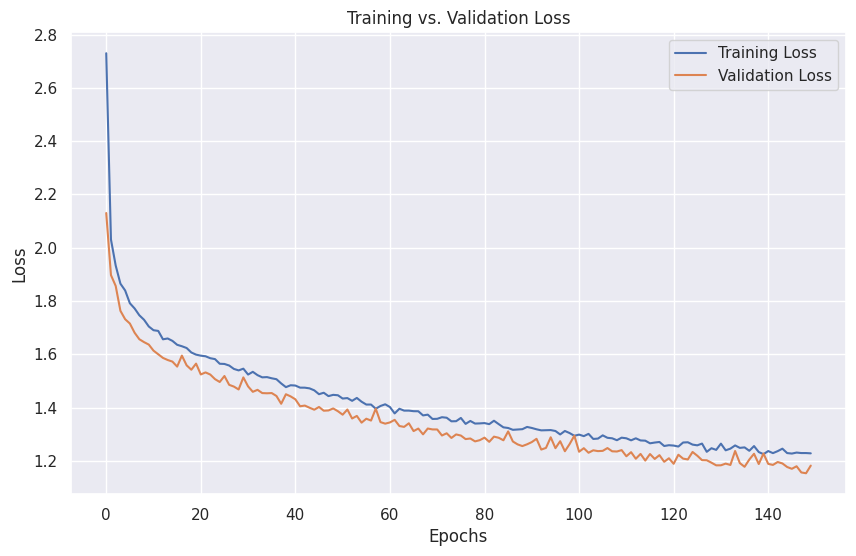

In [53]:

# Plotting the training and validation loss
plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training vs. Validation Loss')
plt.legend()
plt.show()

In [54]:
y_pred_probs = model.predict(z2)
y_pred = y_pred_probs.argmax(axis=1)

y_test_labels = y_test_encoded.argmax(axis=1)
test_loss, test_accuracy = model.evaluate(z2, y_test_encoded)

print(f"Test Loss: {test_loss}")
print(f"Test Accuracy: {test_accuracy}")

for i in range(10):
    print(f"Predicted: {y_pred[i]}, Actual: {y_test_labels[i]}")

94/94 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
94/94 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7024 - loss: 1.1597
Test Loss: 1.1543678045272827
Test Accuracy: 0.6940273642539978
Predicted: 5, Actual: 9
Predicted: 5, Actual: 5
Predicted: 5, Actual: 5
Predicted: 8, Actual: 9
Predicted: 1, Actual: 1
Predicted: 8, Actual: 8
Predicted: 8, Actual: 8
Predicted: 3, Actual: 3
Predicted: 7, Actual: 2
Predicted: 8, Actual: 8


In [55]:
test_loss,test_acc=model.evaluate(z2,y_test_encoded,batch_size=256)
print("The test loss is ",test_loss)
print("The best accuracy is: ",test_acc*100)

12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.7006 - loss: 1.1616
The test loss is  1.1543679237365723
The best accuracy is:  69.40273642539978


Validation Accuracy 0.696211576461792


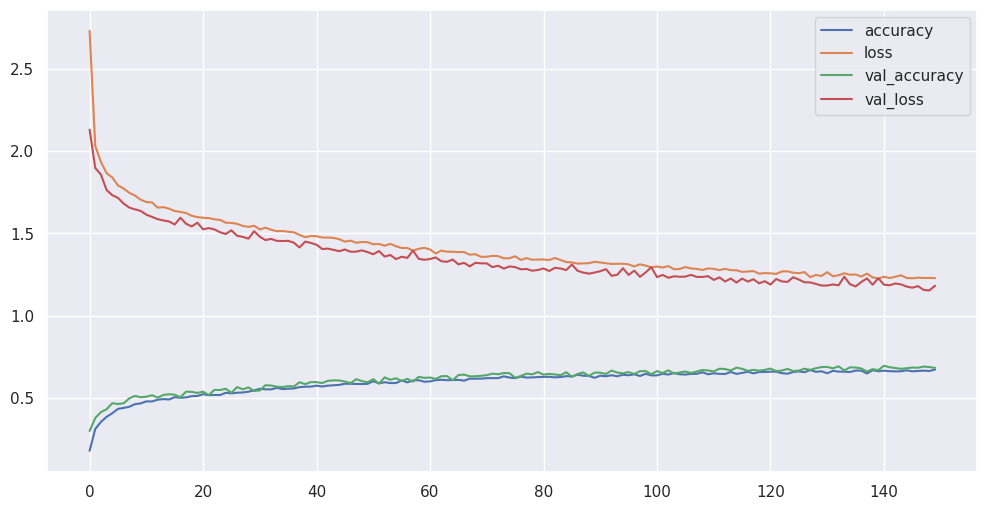

In [56]:
# The plot dipicts how training and testing data performed
Validation_plot(history)

In [57]:
# Plotting the confusion matrix for analizing the true positives and negatives
import seaborn as sn
#import matplotlib.pyplot as plt
#pred_x = model.predict(X_test)
#from sklearn.metrics import confusion_matrix

#cm = confusion_matrix(y_test,pred_x )

#sns.set(rc = {'figure.figsize':(9,4)})
#sns.heatmap(cm, annot=True)


In [152]:
import os

print("Files in kaggle/input:")
for root, dirs, files in os.walk("/kaggle/input"):
    print(f"Directory: {root}")
    for file in files:
        print(f"  File: {file}")


Files in kaggle/input:


In [153]:
DATASET_PATH = '/kaggle/input/gtzan-music-genre-dataset'


In [155]:
DATASET_PATH = '/kaggle/input'
JSON_PATH = './fenil.json'
SAMPLE_RATE = sr =  22050
DURATION = 30 #measured in seconds
SAMPLES_PER_TRACK = SAMPLE_RATE*DURATION

In [156]:
def save_mfcc(dataset_path, json_path, n_mfcc=13, n_fft=4084, hop_length=1024, num_segments=10):
    #dictionary to store data
    data = {
        'mapping' : [],
        'mfcc' : [],
        'labels' : []
    }

    count = 0
    num_samples_per_segment = int(SAMPLES_PER_TRACK / num_segments)
    expected_num_mfcc_vectors_per_segment = math.ceil(num_samples_per_segment / hop_length)


    for i, (dirpath, dirnames, filenames) in enumerate(os.walk(dataset_path)):

        if dirpath not in dataset_path:

            dirpath_components = dirpath.split('/')
            semantic_label = dirpath_components[-1]
            data['mapping'].append(semantic_label)
            print('\nProcessing {}'.format(semantic_label))

            for f in filenames:
                if f.endswith('.wav') and f != 'jazz.00054.wav': # jazz.00054.wav is an empty file

                    file_path = os.path.join(dirpath,f)

                    #loading the audio file
                    signal, sr = sf.read(file_path)
                    # len(signal) = 661794  # sr is 22050 by default

                    #process segments extracting mfcc and storing data
                    for s in range(num_segments):
                        # Since num_segments is defined as 5. Every 30 sec file is divided into 5 segments of length 6sec
                        # Start sample would keep track of the index of the first element of each 6 second batch
                        # finish sample would keep track of the index of the last element of each 6 second batch
                        # And then with the help of python's slice functionality we will extract that 6 second batch from every 30 sec signal
                        start_sample = num_samples_per_segment * s
                        finish_sample = num_samples_per_segment + start_sample

                        # we need to extract, Usually n_mfcc is set b/w 13 to 40. The other parameters n_fft and hop length are

                        mfcc = librosa.feature.mfcc(y=signal[start_sample:finish_sample],sr=sr, n_mfcc=n_mfcc, n_fft=n_fft, hop_length=hop_length)

                        mfcc = mfcc.T
                        if len(mfcc) == expected_num_mfcc_vectors_per_segment:
                            print(mfcc.shape)
                            data['mfcc'].append(mfcc.tolist())
                            data['labels'].append(i)
                            print('Processing {}, segment:{}'.format(file_path, s))
                            count += 1
                            print(count)
    with open(json_path, 'w') as fp:
        json.dump(data, fp, indent=4)



In [90]:
def load_data(json_path):
    with open(json_path, "r") as fp:
        data = json.load(fp)

    if len(data["mfcc"]) == 0 or len(data["labels"]) == 0:
        print("Error: No data found in JSON file. Please check the data saving process.")
        return None, None

    inputs = np.array(data["mfcc"])
    targets = np.array(data["labels"])
    return inputs, targets


In [68]:
import math

In [157]:
save_mfcc(DATASET_PATH, JSON_PATH, num_segments=10)

In [70]:
# loading the saved Json file
def load_data(path):
    with open(path, 'r') as fp:
        data = json.load(fp)

    #Convert lists into numpy arrays
    inputs = data['mfcc']
    targets = data['labels']
    return np.array(inputs), np.array(targets)

In [71]:
inputs, targets = load_data('./fenil.json')

In [72]:
print(inputs)

[]


In [73]:
np.unique(targets, return_counts=True)

(array([], dtype=float64), array([], dtype=int64))

In [116]:
save_mfcc(DATASET_PATH, "fenil.json")


Saving data to fenil.json...
Data saved successfully.


In [104]:
{
    "mapping": ["genre1", "genre2", ...],
    "mfcc": [[...], [...], ...],
    "labels": [0, 1, 2, ...]
}


{'mapping': ['genre1', 'genre2', Ellipsis],
 'mfcc': [[Ellipsis], [Ellipsis], Ellipsis],
 'labels': [0, 1, 2, Ellipsis]}

In [111]:
def load_data(json_path):
    try:
        with open(json_path, "r") as fp:
            data = json.load(fp)
    except Exception as e:
        print(f"Error loading JSON file: {e}")
        return None, None

    # Check if the JSON file contains valid data
    if len(data["mfcc"]) == 0 or len(data["labels"]) == 0:
        print("Error: The JSON file contains no data. Please check the data generation step.")
        return None, None

    inputs = np.array(data["mfcc"])
    targets = np.array(data["labels"])
    return inputs, targets


In [95]:
np.unique(targets, return_counts=True)

(array([None], dtype=object), array([1]))

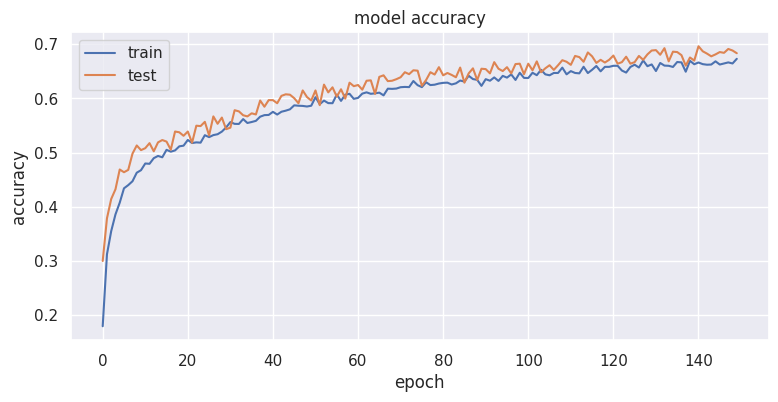

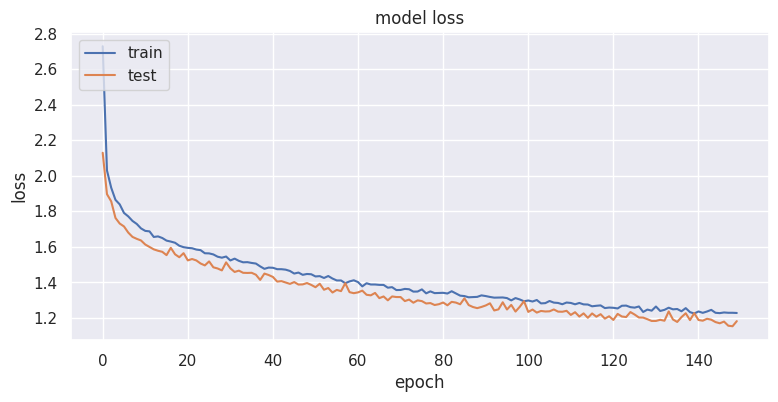

In [101]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()